# Welcome to the -- Tutorial!

This Notebook calculate the scattering & intrinsic absorption parameters of the Rayleigh waves following the instruction proposed by Hirose et al. (2019).

## **Publication about this script**:
Hirose, T., Nakahara, H., & Nishimura, T. (2019). A passive estimation method of scattering and intrinsic absorption parameters from envelopes of seismic ambient noise cross‐correlation functions. Geophysical Research Letters, 46(7), 3634-3642. https://doi.org/10.1029/2018GL080553




Step: <br>
0) Filtering <br> 1) Calculation of mean-squared (MS) envelopes <br> 2) Selection of MS envelopes by SNR (e.g. inter-station distances <10 km and SNR>3) <br>
3) Selection of observed energy densities <br>
4) Calculation of synthesized energy densities via a grid search <br>
--- The search range of l (b) was between 0.4 and 10 km (0.00–0.40 s−1) with an increment of 0.1 km (0.02 s−1) <br>
5) Determination of best-fit parameters <br>

In [1]:
#from noisepy.seis.asdfstore import ASDFCCStore, ASDFStackStore      # Object to store ASDF data within noisepy
import os
import sys
import glob
import obspy

#import h5py
import numpy as np

import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib as mpl
import pyasdf
import scipy
import math

from obspy.signal.filter import bandpass

In [2]:
path = "./" 
#data_path = os.path.join(path, "STACK_HH_rma")
#sfiles = sorted(glob.glob(os.path.join(data_path, '**/*.h5')))
data_path = os.path.join(path, "STACK_BH_Rainier")
sfiles = sorted(glob.glob(os.path.join(data_path, '*PANH*/*.h5')))

#data_path = os.path.join(path, "CCF")
#sfiles = sorted(glob.glob(os.path.join(data_path, '*.h5')))
print(sfiles)


['./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.CARB.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.OBSR.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PANH.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR01.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR02.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR03.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR04.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR05.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.RUSH.h5', './STACK_BH_Rainier/CC.PANH/CC.PANH_CC.SIFT.h5']


## Read in HDF5 files

10
(10, 2, 8001)
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.CARB.h5 that is 31.15km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.OBSR.h5 that is 13.92km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PANH.h5 that is  0.00km apart. dt: 0.050000 
skip autocorrelation. 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR01.h5 that is 30.64km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR02.h5 that is 31.64km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR03.h5 that is 30.14km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR04.h5 that is 27.51km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.PR05.h5 that is 23.44km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.RUSH.h5 that is 23.52km apart. dt: 0.050000 
working on ./STACK_BH_Rainier/CC.PANH/CC.PANH_CC.SIFT.h5 that is 23.70km apart. dt: 0.050000 


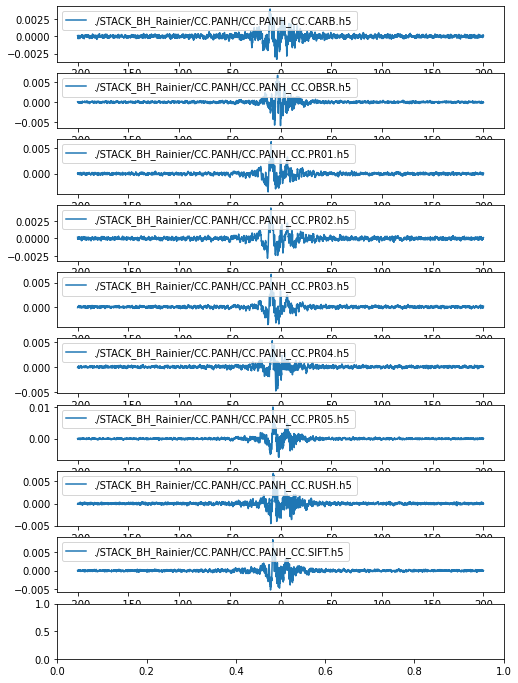

In [7]:
fnum=len(sfiles)
print(fnum)

fig, ax = plt.subplots(fnum, figsize=(8, 12), sharex=False)

stackf=np.ndarray((fnum,2,8001))  
print(stackf.shape)
vdist=np.zeros((fnum,1))  # S-R distance array
fname=[]                  # file name array

ccomp = "ZZ"              # component 
lag=200

aa=0
# loop through each station-pair
for sfile in sfiles:
    
    # useful parameters from each asdf file
    with pyasdf.ASDFDataSet(sfile, mode="r") as ds:
        #print(ds,"\n")
        alist = ds.auxiliary_data.list()
        try:
            dt = ds.auxiliary_data[alist[0]][ccomp].parameters["dt"]
            dist = ds.auxiliary_data[alist[0]][ccomp].parameters["dist"]
            #npts = ds.auxiliary_data[alist[0]][ccomp].parameters["npts"]            
        except Exception:
            print("continue! no %s component exist" % ccomp)
            continue
        print("working on %s that is %5.2fkm apart. dt: %f " % (sfile, dist,dt))
        if dist == 0: 
            print("skip autocorrelation. ")
            continue
        # stacked data and filter it
        sdata = ds.auxiliary_data[alist[0]][ccomp].data[:]
        para = ds.auxiliary_data[alist[0]][ccomp].parameters

        # time domain variables
        nwin = len(alist[1:])
        npts = sdata.size
        tvec = np.arange(-npts // 2 + 1, npts // 2 + 1) * dt
        indx = np.where(np.abs(tvec) <= lag)[0]
        tvec = np.arange(-npts // 2 + 1, npts // 2 + 1) * dt
    
    ### stacked waveforms
    stackf[aa]=[tvec,sdata]
    vdist[aa]=dist
    fname.append(sfile.split("/")[3])
    ax[aa].plot(tvec, sdata)
    ax[aa].legend([sfile], loc="upper left")
    ax[aa].set_xlabel("time [s]")
    aa=aa+1

#fig.tight_layout()
#plt.show()
fnum=len(fname)


### Step 0 --- Filtering

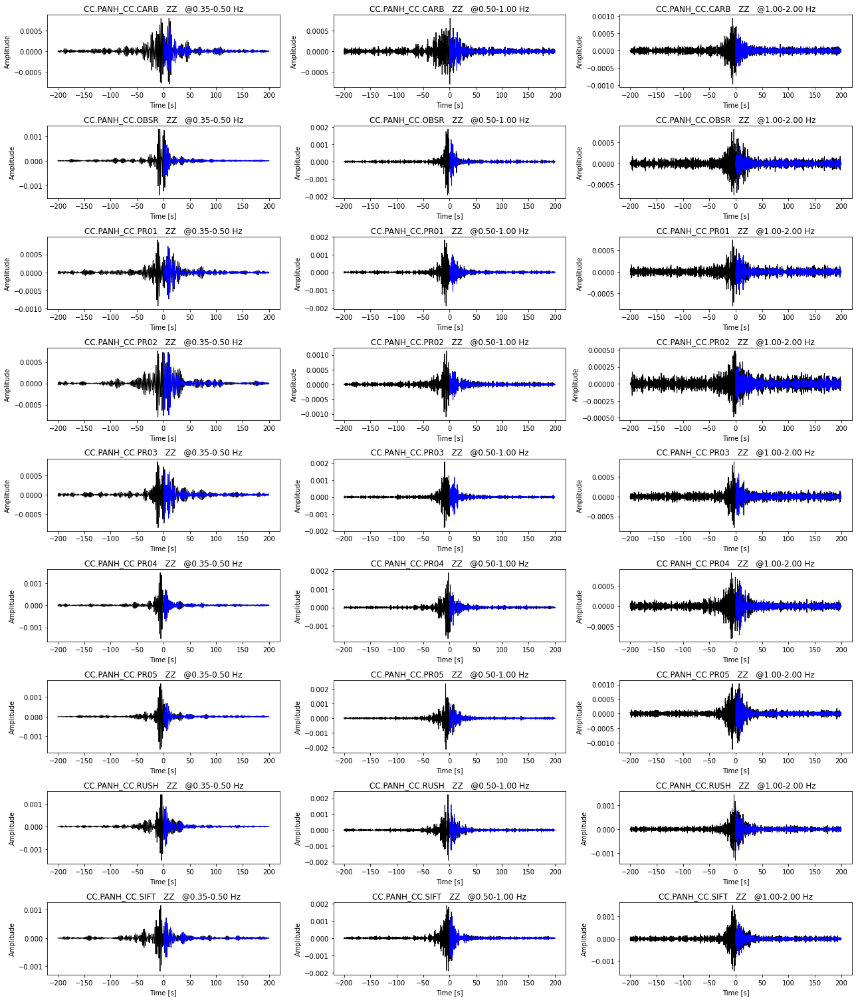

In [8]:
freq = [0.35, 0.5,1, 2]  # targeted frequency band for waveform monitoring
nfreq = len(freq) - 1

indx = npts // 2                      # half-side number of points 
MSE=np.ndarray((fnum,nfreq+1,indx+1)) # filtered two-side averaged stack CF
data_sym=np.ndarray((nfreq+1,indx+1)) # two-side averaged stack CF

fig, ax = plt.subplots(fnum,3, figsize=(18,21), sharex=False)

for aa in range (fnum):
    dafbp=np.ndarray((nfreq,npts))
    for fb in range(nfreq):
        fmin=freq[fb]
        fmax=freq[fb+1]
        tt = np.arange(0, npts) * dt
        data = stackf[aa][1]
        dafbp[fb] = bandpass(data, fmin, fmax, int(1 / dt), corners=4, zerophase=True)
        

        # stack positive and negative lags  
        sym = 0.5 * dafbp[fb][indx:] + 0.5 * np.flip(dafbp[fb][: indx + 1], axis=0)
        data_sym[fb]=sym
        ax[aa][fb].plot(stackf[aa][0], dafbp[fb], "k-", linewidth=1)
        ax[aa][fb].plot(stackf[aa][0][indx:], data_sym[fb], "b-", linewidth=1)
        ax[aa][fb].set_title( "%s   %s   @%4.2f-%4.2f Hz" % ( fname[aa].split(".h5")[0],ccomp,fmin,fmax ) )
        ax[aa][fb].set_xlabel("Time [s]")
        ax[aa][fb].set_ylabel("Amplitude")
    MSE[aa]=[stackf[aa][0][indx:],data_sym[0],data_sym[1],data_sym[2]]
plt.tight_layout()
plt.show()

### Step 1 --- Calculation of mean-squared (MS) envelopes --> ***Eobs***  <br>
**need to add coda normalization** <br>
*/"The summed MS envelope was then normalized using their values at lapse times greater than twice the arrival times of direct Rayleigh waves for farthest station pairs (coda normalization)"*

--> normalized MS envelope is referred to as the observed energy density Eobs 

In [9]:
#Python3 program to calculate Mean Square
import math
#Function that Calculate Mean Square
def msValue(arr, n):
    square = 0
    mean = 0.0
    
    #Calculate square
    for i in range(0,n):
        square += (arr[i]**2)
     
    #Calculate Mean
    mean = square / (float)(n)
    
    return mean

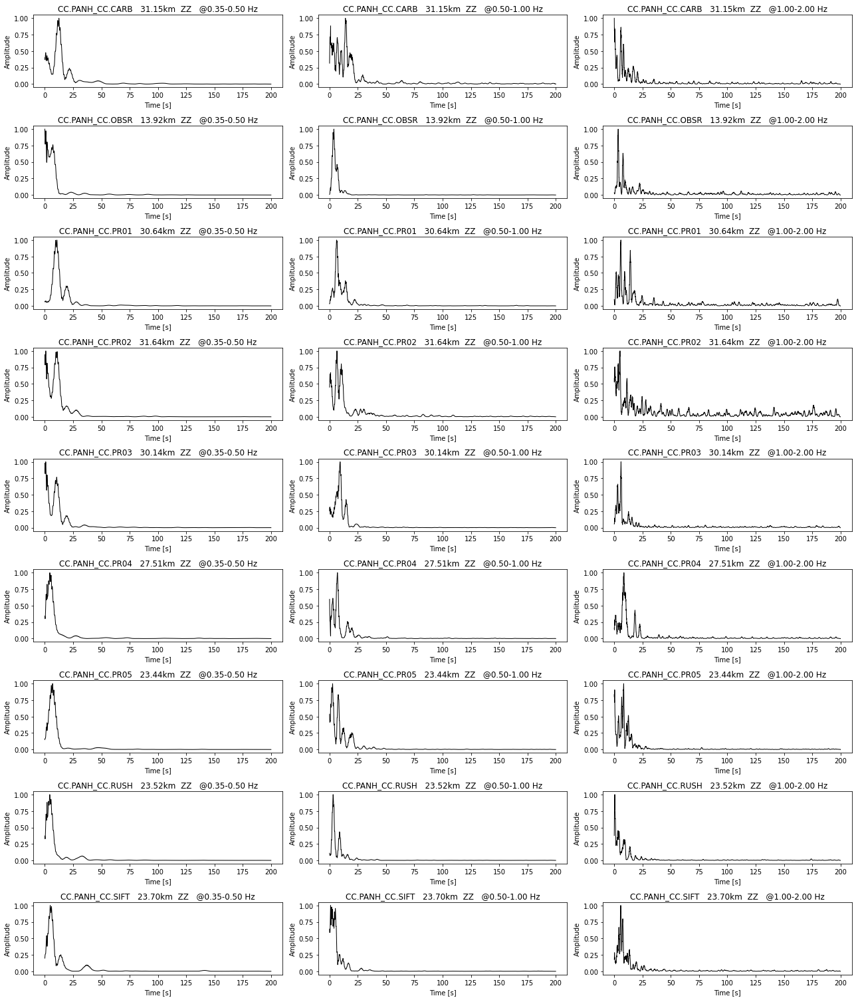

In [10]:
msv=np.ndarray((fnum,nfreq+1,indx+1))
msv[:][:][:]=0.
#print(msv.shape)

fig, ax = plt.subplots(fnum,3, figsize=(18,21), sharex=False)

winlen=[4,2,1]   # smoothing window lengths corresponding to the frequency bands
for aa in range(fnum):
    msv[aa][0]=MSE[aa][0][:]
    for fb in range(nfreq):
        data=MSE[aa][fb+1][:]
        fmin=freq[fb]
        fmax=freq[fb+1]
        
        # small window smoothing
        npt=int(winlen[fb]/dt)+1
        half_npt=int(npt/2)
        arr=np.zeros(int(npt))
        for jj in range(0, (npts//2)):
            if jj < half_npt:
                arr=data[jj: jj+half_npt]
            elif jj > (npts//2)-half_npt:
                arr=data[jj: npts]
            else:
                arr=data[jj-half_npt : jj+half_npt]
            msv[aa][fb+1][jj] = msValue(arr,len(arr))
        
        msv[aa][fb+1]=msv[aa][fb+1]/np.max(msv[aa][fb+1])  # self-normalized --> need to be updated by coda normalization
        ax[aa][fb].plot(msv[aa][0][:], msv[aa][fb+1], "k-", linewidth=1)
        ax[aa][fb].set_title("%s   %.2fkm  %s   @%4.2f-%4.2f Hz" % (fname[aa].split(".h5")[0],vdist[aa],ccomp,fmin,fmax))
        ax[aa][fb].set_xlabel("Time [s]")
        ax[aa][fb].set_ylabel("Amplitude")
plt.tight_layout()
plt.show()

### Step 2 ---  Selection of MS envelopes by SNR 


### Step 3 --- Selection of observed energy densities 

### Step 4 --- Calculation of synthesized energy densities via a grid search 
### #The 2-D radiative transfer equation for scalar waves  ***(Shang and Gao 1988; Sato 1993)***
Assuming isotropic scattering and source radiation in infinite medium to calculate ***synthesized energy densities  Esyn*** :

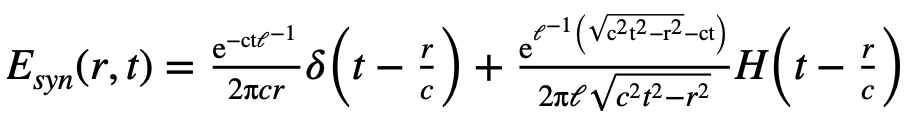

* l scattering mean free paths 
* c is the Rayleigh wave velocity
* r is the distance between the source and receiver
* H is the Heaviside function

* ### ***b is intrinsic absorption parameter***


In [14]:
# Dirac delta function
def impulse(x):
    return 1 * (x == 0)  

# Heaviside function (step function)
def step(x):
    return 1 * (x > 0)

# Esyn -->The 2-D radiative transfer equation for scalar waves 
def ESYN_RadiaTrans(mean_free,tm, r, c):
       
    s0=c**2 * tm**2 -r**2
    if s0 > 0:
        # first term
        a1up=math.exp(-1 * c * tm * (mean_free**(-1)))
        a1bot= 2 * math.pi * c * r
        #first= (a1up/a1bot)* scipy.signal.unit_impulse( tm-r/c ,'mid')
        first= (a1up/a1bot)* impulse( tm-r/c )
        
        # second term
        ind2=mean_free**(-1) * (math.sqrt(s0)-c*tm)
        a2up=math.exp(ind2)
        a2bot=2 * math.pi * mean_free * math.sqrt(s0)
        #second=(a2up)/(a2bot)* math.heaviside(tm-r/c)
        second=(a2up/a2bot)* step(tm-r/c)
        
        #print("A1: %.4f %.4f %.4f " % ((a1up/a1bot),a1up,a1bot),"  , A2: %.4f %.4f %.4f " % ((a2up/a2bot),a2up,a2bot))    
        Esyn= first + second
    
        return Esyn

The sum of squared residuals (SSR) between *Eobs and Esyn* was calculated, and the values of the parameters l and b that minimize SSR through the grid search were determined. <br>

**Here i is the number of time windows and j is the number of station pairs.**

* Hirose et al. (2019) --> 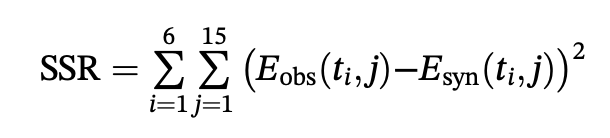  
* Hirose et al. (2022) --> 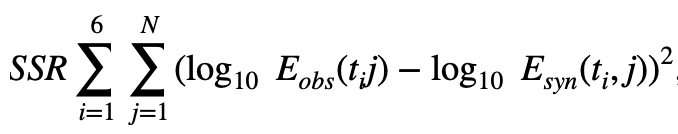

<ipython-input-42-1662c75ca4f8>:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(9,3))


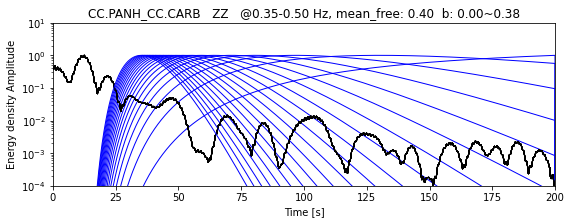

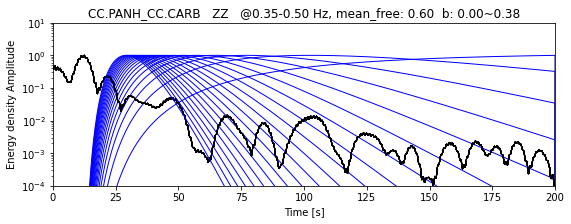

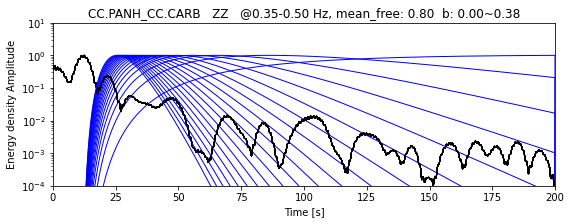

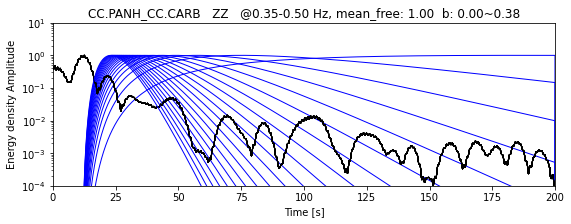

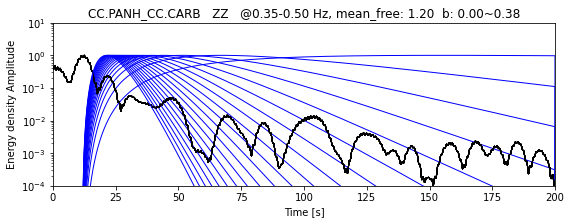

...

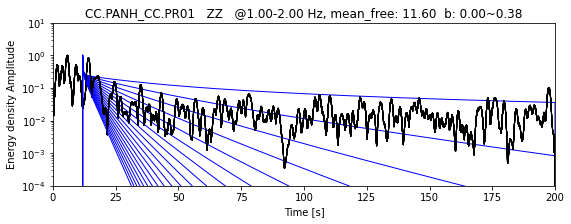

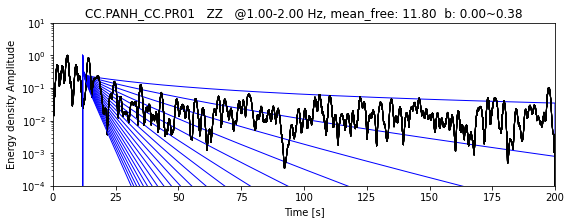

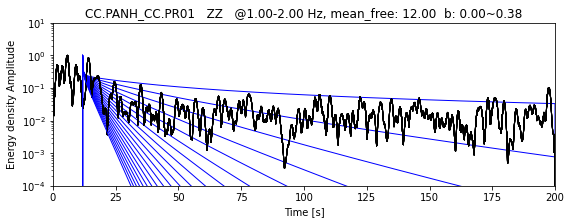

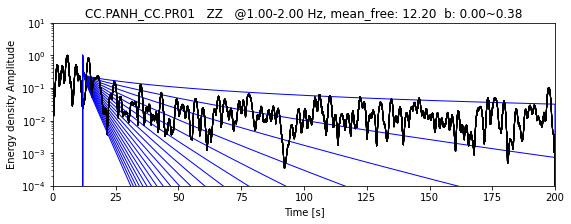

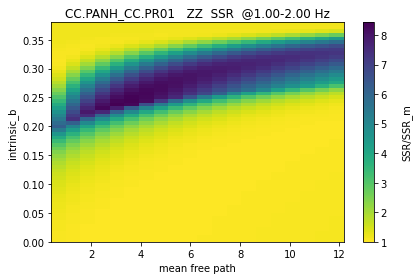

In [42]:
### haven't used multiple components but one.

#twindow=[5.24, 5.74, 6.24, 36.1, 37.1, 37.6] # time windows   --> should be determined depended on station pair 
twindow=[8, 9, 10, 15, 17, 19] 
c=2.6                                      # phase velocity --> should be vary

x=np.zeros(60)    # mean_free_path search array
y=np.zeros(20)     # intrinsic_b search array
SSR=np.ndarray((fnum,nfreq,len(x),len(y)))
SSR[:][:][:][:]=0.
Esyn=np.ndarray((fnum,nfreq+1,len(x),len(y)))
Esyn[:][:][:][:]=0.

Esyn_temp=np.ndarray((len(x),len(y),npts//2+1))
Eobs_temp=np.ndarray((len(x),len(y),npts//2+1))

#for aa in range(fnum):
for aa in range(0,3):
    r=float(vdist[aa])
    for fb in range(nfreq):
        fmin=freq[fb]
        fmax=freq[fb+1]
        # grid search in combination of mean_free_path and intrinsic_b
        Esyn_temp[:][:][:]=0.
        Eobs_temp[:][:][:]=0.
        for nfree in range(len(x)):
            mean_free= 0.4 + 0.2 *nfree
            x[nfree]=mean_free
            
            plt.figure(figsize=(9,3))
            for nb in range(len(y)):
                intrinsic_b=0.02*nb
                y[nb]=intrinsic_b
                
                # calculate the Esyn and SSR for combination of mean_free_path and intrinsic_b
                for twn in range(npts//2):
                    tm=dt*twn
                    Eobs_temp[nfree][nb][twn]= msv[aa][fb+1][twn]
                    
                    s0=c**2 * tm**2 -r**2
                    if s0 < 0:
                        #print(twn,tm,s0,tm-r/c)
                        continue
                        
                    tmp=ESYN_RadiaTrans(mean_free, tm , r, c)
                    Esyn_temp[nfree][nb][twn]= tmp * math.exp(-1* intrinsic_b * tm)  
                Esyn_temp[nfree][nb]=Esyn_temp[nfree][nb]/np.max(Esyn_temp[nfree][nb])
                
                plt.yscale('log', base=10)
                plt.xlim(0,200) 
                plt.ylim( pow(10,-4),pow(10,1))
                #plt.axis([0,100, np.min(Eobs_temp[nfree][nb]), np.max(Eobs_temp[nfree][nb])])
                plt.plot( msv[aa][0][:], Eobs_temp[nfree][nb], "k-", linewidth=1)
                plt.plot( msv[aa][0][:], Esyn_temp[nfree][nb], "b-", linewidth=1)
                                      
                #### specific window
                for tsn in range(len(twindow)):
                    tsb=int(twindow[tsn]//dt)
                    tse=int((twindow[tsn]+1)//dt)
                    SSR_temp=0. 
                    for twn in range(tsb,tse):
                        #SSR_temp+=(math.log10(Eobs_temp[nfree][nb][twn]) - math.log10(Esyn_temp[nfree][nb][twn]))**2
                        SSR_temp+=((Eobs_temp[nfree][nb][twn]) - (Esyn_temp[nfree][nb][twn]))**2
                        #print("twn",twn,tsb,tse,"Eobs %.2f" % Eobs_temp[nfree][nb][twn],
                        #      "Esyn %.2e" % Esyn_temp[nfree][nb][twn],"SSR_temp %.2f" % SSR_temp)
                    SSR[aa][fb][nfree][nb]+=SSR_temp
                    #print("### tsn",tsn,"SSR_temp %.2f" % SSR_temp)
                
            #print("mean_free: %.2f " % mean_free,", intrinsic_b %.2f " %  intrinsic_b,"SSR: %.4f" % SSR_temp)
            plt.title("%s   %s   @%4.2f-%4.2f Hz, mean_free: %.2f  b: %.2f~%.2f"
                % ( fname[aa].split(".h5")[0],ccomp,fmin,fmax,mean_free,y[0],y[-1]))
            plt.xlabel("Time [s]")
            plt.ylabel("Energy density Amplitude")
            
        #SSR[aa][fb]= SSR[aa][fb] / np.max(SSR[aa][fb][:][:])
        SSR[aa][fb]= SSR[aa][fb] / (np.min(SSR[aa][fb][:][:])+math.exp(-6))
        #print(aa,fb,SSR.shape, np.max(SSR[aa][fb]),np.min(SSR[aa][fb]) , np.argmin(np.min(SSR[aa][fb])))
        plt.figure(figsize=(6,4))
        grid = SSR[aa][fb] #.reshape((len(x), len(y)))
        plt.title("%s   %s  SSR  @%4.2f-%4.2f Hz" % (fname[aa].split(".h5")[0],ccomp,fmin,fmax) )
        plt.xlabel("mean free path")
        plt.ylabel("intrinsic_b")
        im=plt.imshow(grid, extent=(x.min(), x.max(), y.min(), y.max()),aspect='auto',cmap = 'viridis_r' )
        cb=plt.colorbar(im) #, mpl.cm.ScalarMappable(norm=norm)
        #plt.clim(0,np.max(SSR[aa][fb][:][:]))
        #plt.plot(,"+")
        cb.set_label('SSR/SSR_m', rotation=90, labelpad=14)
        
plt.tight_layout()
plt.show()     

### Step 5 --- Determination of best-fit parameters 